<a href="https://colab.research.google.com/github/coltongerth/Mimic3-NLP/blob/main/MIMIC3_NLP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install --upgrade chart_studio
!pip install spacy
!pip install medspacy
!python3 -m spacy download en_core_web_lg
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.5.1/en_core_sci_lg-0.5.1.tar.gz

2025-02-20 20:10:59.213472: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1740082259.237937   37840 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1740082259.245489   37840 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-20 20:10:59.270680: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-02-20 20:11:04.140603: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL

In [2]:
import spacy
import medspacy
import numpy as np
from gensim.models import Word2Vec
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.optimize
import chart_studio
import chart_studio.plotly as py
import plotly.graph_objects as go
import plotly.io as pio
import plotly.express as px
from spacy import displacy
from tqdm import tqdm  # for progress tracking
from google.colab import files, data_table

data_table.enable_dataframe_formatter()

Google Colab Link: https://colab.research.google.com/drive/1W7JIYtq1qyvw9foTKrKIaWuIBmOCmg72?usp=sharing

In [3]:
#@title Provide Google Credentials to Colab Runtime (May Require Manually Copy/Pasting Authentication Code)
from google.colab import auth
auth.authenticate_user()
print('Authenticated')

Authenticated


In [4]:
project_id = 'ai-in-healthcare-449320' #@param{type:"string"}

# Package used for interfacing w/ BigQuery from Python
from google.cloud import bigquery

# Create BigQuery client
bq_client = bigquery.Client(project = project_id)

In [5]:
query = """
SELECT
    n.subject_id,
    n.hadm_id,
    n.chartdate,
    n.DESCRIPTION,
    n.TEXT,
    d.icd9_code,
    d.seq_num,
    dicd.short_title,
    dicd.LONG_TITLE
FROM `physionet-data.mimiciii_notes.noteevents` n
JOIN `physionet-data.mimiciii_clinical.diagnoses_icd` d
ON n.subject_id = d.subject_id AND n.hadm_id=d.hadm_id
JOIN `physionet-data.mimiciii_clinical.d_icd_diagnoses` dicd
ON dicd.icd9_code = d.icd9_code AND dicd.icd9_code="5849"
limit 1500;

"""
# 584.9 Acute kidney failure NOS
df = bq_client.query(query).to_dataframe()
df

,subject_id,hadm_id,chartdate,DESCRIPTION,TEXT,icd9_code,seq_num,short_title,LONG_TITLE
0,10187,138921,2141-08-21,Report,Sinus rhythm\nLead(s) unsuitable for analysis:...,5849,20,Acute kidney failure NOS,"Acute kidney failure, unspecified"
1,31011,104948,2154-12-20,Report,Atrial fibrillation with rapid ventricular res...,5849,14,Acute kidney failure NOS,"Acute kidney failure, unspecified"
2,24915,194424,2182-12-12,Report,Sinus rhythm\nPoor R wave progression - probab...,5849,14,Acute kidney failure NOS,"Acute kidney failure, unspecified"
3,53734,176182,2131-03-03,Report,Sinus rhythm\nConsider ectopic atrial rhythm\n...,5849,14,Acute kidney failure NOS,"Acute kidney failure, unspecified"
4,8060,125303,2164-01-09,Report,PATIENT/TEST INFORMATION:\nIndication:\n. Pulm...,5849,15,Acute kidney failure NOS,"Acute kidney failure, unspecified"
...,...,...,...,...,...,...,...,...,...
1495,12337,149181,2135-12-08,Report,Baseline artifact. Sinus tachycardia. Left axi...,5849,13,Acute kidney failure NOS,"Acute kidney failure, unspecified"
1496,32624,118491,2106-06-17,Report,Atrial flutter\nProbable intermittent aberrant...,5849,13,Acute kidney failure NOS,"Acute kidney failure, unspecified"
1497,5955,117177,2129-02-01,Report,Sinus rhythm followed by pause and junctional ...,5849,13,Acute kidney failure NOS,"Acute kidney failure, unspecified"
1498,29299,120896,2192-11-24,Report,Normal sinus rhythm with occasional premature ...,5849,13,Acute kidney failure NOS,"Acute kidney failure, unspecified"


In [6]:
def process_clinical_note(text):
    # Process the text with spaCy
    doc = nlp(text)

    # Extract basic information
    entities = [(ent.text, ent.label_) for ent in doc.ents]

    tokens = [token.text.lower() for token in doc]

    return {
        'entities': entities,
        'tokens': tokens
    }

# Load the scientific model
nlp = spacy.load("en_core_web_lg")

# Apply the processing to a sample of notes (start with a small sample first)
sample_size = 1500
sample_df = df.head(sample_size)

# Process notes and store results
results = []
for idx, row in tqdm(sample_df.iterrows(), total=len(sample_df)):
    try:
        processed = process_clinical_note(row['TEXT'])
        results.append({
            'subject_id': row['subject_id'],
            'hadm_id': row['hadm_id'],
            'chartdate': row['chartdate'],
            'processed_data': processed
        })
    except Exception as e:
        print(f"Error processing record {idx}: {e}")

# Convert results to DataFrame
results_df = pd.DataFrame(results)

100%|██████████| 1500/1500 [02:52<00:00,  8.68it/s]


In [7]:
results_df

,subject_id,hadm_id,chartdate,processed_data
0,10187,138921,2141-08-21,"{'entities': [('V4 Nonspecific', 'PRODUCT')], ..."
1,31011,104948,2154-12-20,"{'entities': [('earlier same date', 'DATE')], ..."
2,24915,194424,2182-12-12,"{'entities': [('Septal', 'ORG')], 'tokens': ['..."
3,53734,176182,2131-03-03,"{'entities': [('Q-Tc', 'PRODUCT'), ('2131', 'C..."
4,8060,125303,2164-01-09,"{'entities': [('63', 'CARDINAL'), ('165', 'CAR..."
...,...,...,...,...
1495,12337,149181,2135-12-08,"{'entities': [('Baseline', 'ORG')], 'tokens': ..."
1496,32624,118491,2106-06-17,"{'entities': [('2106-6-17', 'CARDINAL')], 'tok..."
1497,5955,117177,2129-02-01,"{'entities': [('40', 'CARDINAL')], 'tokens': [..."
1498,29299,120896,2192-11-24,"{'entities': [('2192-11-21', 'CARDINAL')], 'to..."


In [17]:
def visualize_clinical_note(text, index=0):
    for i in text:
      doc = nlp(i[0])

      # Generate HTML for entity visualization
      ent_html = displacy.render(doc, style="ent", jupyter=True)


# If you want to visualize multiple notes:
print(results_df)
for i, row in results_df.iterrows():
    if i % 100 == 0:
        print(f"\nNote {i+1}:")
        print("-" * 50)
        visualize_clinical_note(row['processed_data']["entities"], i)

      subject_id  hadm_id   chartdate  \
0          10187   138921  2141-08-21   
1          31011   104948  2154-12-20   
2          24915   194424  2182-12-12   
3          53734   176182  2131-03-03   
4           8060   125303  2164-01-09   
...          ...      ...         ...   
1495       12337   149181  2135-12-08   
1496       32624   118491  2106-06-17   
1497        5955   117177  2129-02-01   
1498       29299   120896  2192-11-24   
1499       27661   108415  2129-07-13   

                                         processed_data  
0     {'entities': [('V4
Nonspecific', 'PRODUCT')], ...  
1     {'entities': [('earlier same date', 'DATE')], ...  
2     {'entities': [('Septal', 'ORG')], 'tokens': ['...  
3     {'entities': [('Q-Tc', 'PRODUCT'), ('2131', 'C...  
4     {'entities': [('63', 'CARDINAL'), ('165', 'CAR...  
...                                                 ...  
1495  {'entities': [('Baseline', 'ORG')], 'tokens': ...  
1496  {'entities': [('2106-6-17', 'CARDINAL


Note 101:
--------------------------------------------------



Note 201:
--------------------------------------------------



Note 301:
--------------------------------------------------



Note 401:
--------------------------------------------------



Note 501:
--------------------------------------------------



Note 601:
--------------------------------------------------



Note 701:
--------------------------------------------------



Note 801:
--------------------------------------------------



Note 901:
--------------------------------------------------

Note 1001:
--------------------------------------------------



Note 1101:
--------------------------------------------------



Note 1201:
--------------------------------------------------



Note 1301:
--------------------------------------------------



Note 1401:
--------------------------------------------------


In [9]:
def process_clinical_note(text):
    # Process the text with spaCy
    doc = sci_spa_nlp(text)

    # Extract basic information
    entities = [(ent.text, ent.label_) for ent in doc.ents]

    tokens = [token.text.lower() for token in doc]

    return {
        'entities': entities,
        'tokens': tokens
    }

# Load the scientific model
sci_spa_nlp = spacy.load("en_core_sci_lg")

sample_size = 1500
sample_df = df.head(sample_size)

# Process notes and store results
results = []
for idx, row in tqdm(sample_df.iterrows(), total=len(sample_df)):
    try:
        processed = process_clinical_note(row['TEXT'])
        results.append({
            'subject_id': row['subject_id'],
            'hadm_id': row['hadm_id'],
            'chartdate': row['chartdate'],
            'processed_data': processed
        })
    except Exception as e:
        print(f"Error processing record {idx}: {e}")

# Convert results to DataFrame
sci_spa_results_df = pd.DataFrame(results)

100%|██████████| 1500/1500 [03:12<00:00,  7.81it/s]


In [18]:
def visualize_clinical_note(text, index=0):
    for i in text:
      doc = sci_spa_nlp(i[0])

      # Generate HTML for entity visualization
      ent_html = displacy.render(doc, style="ent", jupyter=True)


# If you want to visualize multiple notes:
print(sci_spa_results_df)
for i, row in sci_spa_results_df.iterrows():
    if i % 100 == 0:
        print(f"\nNote {i+1}:")
        print("-" * 50)
        visualize_clinical_note(row['processed_data']["entities"], i)

      subject_id  hadm_id   chartdate  \
0          10187   138921  2141-08-21   
1          31011   104948  2154-12-20   
2          24915   194424  2182-12-12   
3          53734   176182  2131-03-03   
4           8060   125303  2164-01-09   
...          ...      ...         ...   
1495       12337   149181  2135-12-08   
1496       32624   118491  2106-06-17   
1497        5955   117177  2129-02-01   
1498       29299   120896  2192-11-24   
1499       27661   108415  2129-07-13   

                                         processed_data  
0     {'entities': [('Sinus rhythm', 'ENTITY'), ('an...  
1     {'entities': [('Atrial fibrillation', 'ENTITY'...  
2     {'entities': [('Sinus rhythm
Poor', 'ENTITY'),...  
3     {'entities': [('Sinus rhythm', 'ENTITY'), ('ec...  
4     {'entities': [('PATIENT/TEST', 'ENTITY'), ('IN...  
...                                                 ...  
1495  {'entities': [('Baseline', 'ENTITY'), ('artifa...  
1496  {'entities': [('Atrial flutter', 'ENT


Note 101:
--------------------------------------------------



Note 201:
--------------------------------------------------



Note 301:
--------------------------------------------------



Note 401:
--------------------------------------------------



Note 501:
--------------------------------------------------



Note 601:
--------------------------------------------------



Note 701:
--------------------------------------------------



Note 801:
--------------------------------------------------



Note 901:
--------------------------------------------------



Note 1001:
--------------------------------------------------



Note 1101:
--------------------------------------------------



Note 1201:
--------------------------------------------------



Note 1301:
--------------------------------------------------



Note 1401:
--------------------------------------------------


In [11]:
from medspacy.ner import TargetRule
from medspacy.visualization import visualize_ent

def process_clinical_note(text):
    # Process the text with spaCy
    doc = med_nlp(text)
    # print(doc)
    # Extract basic information
    entities = [(ent.text, ent.label_) for ent in doc.ents]

    tokens = [token.text.lower() for token in doc]

    return {
        'entities': entities,
        'tokens': tokens
    }

# Load the scientific model
med_nlp = medspacy.load()
# Add rules for target concept extraction
target_matcher = med_nlp.get_pipe("medspacy_target_matcher")
target_rules = [
    TargetRule("acute kidney injury", "PROBLEM"),
    TargetRule("acute kidney injury", "PROBLEM", pattern=[{"LOWER": "afib"}]),
    TargetRule("bleeding", "PROBLEM"),
    TargetRule("pain", "PROBLEM"),
    TargetRule("Chronic Kidney Failure", "PROBLEM"),
    TargetRule("heart failiure", "PROBLEM"),
    TargetRule("hemorrhage", "PROBLEM"),
    TargetRule("ibuprofen", "MEDICATION"),
    TargetRule("medication", "MEDICATION"),
    TargetRule("Tylenol", "MEDICATION"),
    TargetRule("aspirin", "MEDICATION")
]
target_matcher.add(target_rules)


sample_size = 1500
sample_df = df.head(sample_size)

# Process notes and store results
results = []
for idx, row in tqdm(sample_df.iterrows(), total=len(sample_df)):
    try:
        processed = process_clinical_note(row['TEXT'])
        results.append({
            'subject_id': row['subject_id'],
            'hadm_id': row['hadm_id'],
            'chartdate': row['chartdate'],
            'processed_data': processed
        })
    except Exception as e:
        print(f"Error processing record {idx}: {e}")

# Convert results to DataFrame
med_results_df = pd.DataFrame(results)

100%|██████████| 1500/1500 [03:31<00:00,  7.10it/s]


In [19]:
def visualize_clinical_note(text, index=0):
    for i in text:
      doc = med_nlp(i[0])

      # Generate HTML for entity visualization
      ent_html = displacy.render(doc, style="ent", jupyter=True)


# If you want to visualize multiple notes:
print(med_results_df)
for i, row in med_results_df.iterrows():
  if i % 100 == 0:
      print(f"\nNote {i+1}:")
      print("-" * 50)
      visualize_clinical_note(row['processed_data']["entities"], i)

      subject_id  hadm_id   chartdate  \
0          10187   138921  2141-08-21   
1          31011   104948  2154-12-20   
2          24915   194424  2182-12-12   
3          53734   176182  2131-03-03   
4           8060   125303  2164-01-09   
...          ...      ...         ...   
1495       12337   149181  2135-12-08   
1496       32624   118491  2106-06-17   
1497        5955   117177  2129-02-01   
1498       29299   120896  2192-11-24   
1499       27661   108415  2129-07-13   

                                         processed_data  
0     {'entities': [], 'tokens': ['sinus', 'rhythm',...  
1     {'entities': [], 'tokens': ['atrial', 'fibrill...  
2     {'entities': [], 'tokens': ['sinus', 'rhythm',...  
3     {'entities': [], 'tokens': ['sinus', 'rhythm',...  
4     {'entities': [], 'tokens': ['patient', '/', 't...  
...                                                 ...  
1495  {'entities': [], 'tokens': ['baseline', 'artif...  
1496  {'entities': [], 'tokens': ['atrial',


Note 301:
--------------------------------------------------



Note 401:
--------------------------------------------------

Note 501:
--------------------------------------------------



Note 601:
--------------------------------------------------

Note 701:
--------------------------------------------------

Note 801:
--------------------------------------------------



Note 901:
--------------------------------------------------

Note 1001:
--------------------------------------------------

Note 1101:
--------------------------------------------------

Note 1201:
--------------------------------------------------



Note 1301:
--------------------------------------------------

Note 1401:
--------------------------------------------------


In [23]:
def prepare_sentences(results_df):
    # Extract text from the processed data and tokenize
    sentences = []
    for doc in results_df['processed_data']:
        # Access the original text and split into sentences
        # You might need to adjust this based on your actual data structure
        tokens = [token.lower() for token in doc['tokens']]
        sentences.append(tokens)
    return sentences

def train_word2vec(sentences, vector_size=100, window=5, min_count=1):
    model = Word2Vec(sentences=sentences,
                    vector_size=vector_size,
                    window=window,
                    min_count=min_count,
                    workers=4)
    return model

def get_document_vectors(w2v_model, sentences):
    doc_vectors = []

    for sentence in sentences:
        # Get vectors for all words in the document that are in the model's vocabulary
        word_vectors = [w2v_model.wv[word]
                       for word in sentence
                       if word in w2v_model.wv]

        if word_vectors:
            # Average the word vectors for the document
            doc_vector = np.mean(word_vectors, axis=0)
        else:
            # If no words are in vocabulary, use a zero vector
            doc_vector = np.zeros(w2v_model.vector_size)

        doc_vectors.append(doc_vector)

    return np.array(doc_vectors)

def perform_tsne(doc_vectors, perplexity=30, n_iter=1000):
    tsne = TSNE(n_components=2,
                perplexity=perplexity,
                n_iter=n_iter,
                random_state=42)

    return tsne.fit_transform(doc_vectors)

def plot_tsne(tsne_results, title, labels=None):
    plt.figure(figsize=(12, 8))

    if labels is not None:
        scatter = plt.scatter(tsne_results[:, 0],
                            tsne_results[:, 1],
                            c=labels,
                            cmap='viridis',
                            alpha=0.6)
        plt.colorbar(scatter)
    else:
        plt.scatter(tsne_results[:, 0],
                   tsne_results[:, 1],
                   alpha=0.6)

    plt.title(title)

    plt.tight_layout()
    plt.show()

# Main processing pipeline
def visualize_clinical_notes(results_df, title):
    """
    Complete pipeline to process and visualize clinical notes
    """
    # Prepare sentences
    sentences = prepare_sentences(results_df)

    # Train Word2Vec model
    w2v_model = train_word2vec(sentences)

    # Get document vectors
    doc_vectors = get_document_vectors(w2v_model, sentences)

    # Perform t-SNE
    tsne_results = perform_tsne(doc_vectors)

    # Create visualization
    plot_tsne(tsne_results, title)

    return w2v_model, tsne_results

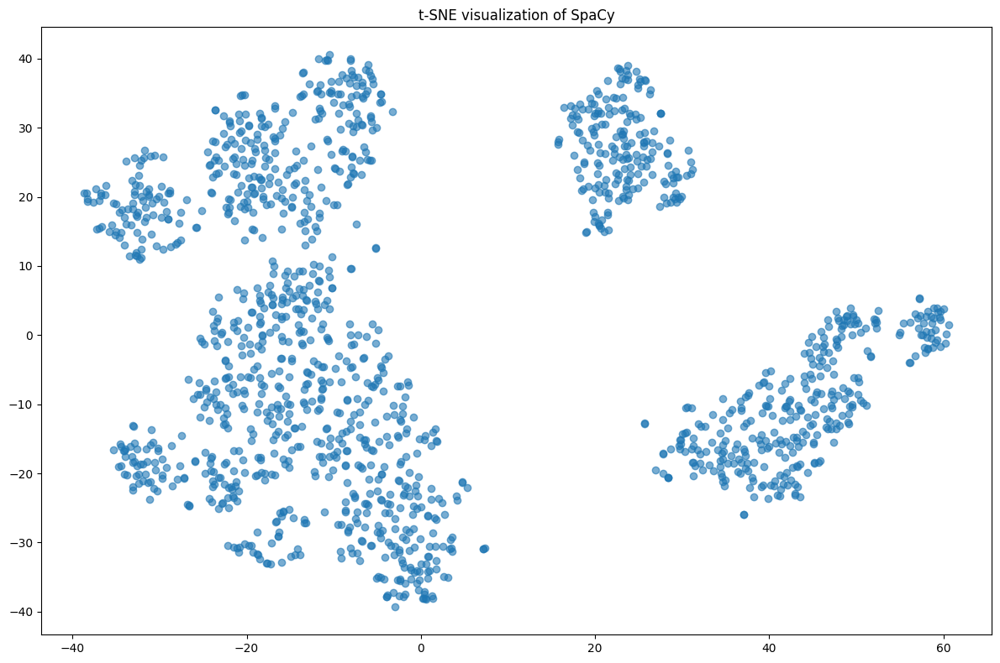

In [24]:
w2v_model, tsne_results = visualize_clinical_notes(results_df, "t-SNE visualization of SpaCy")

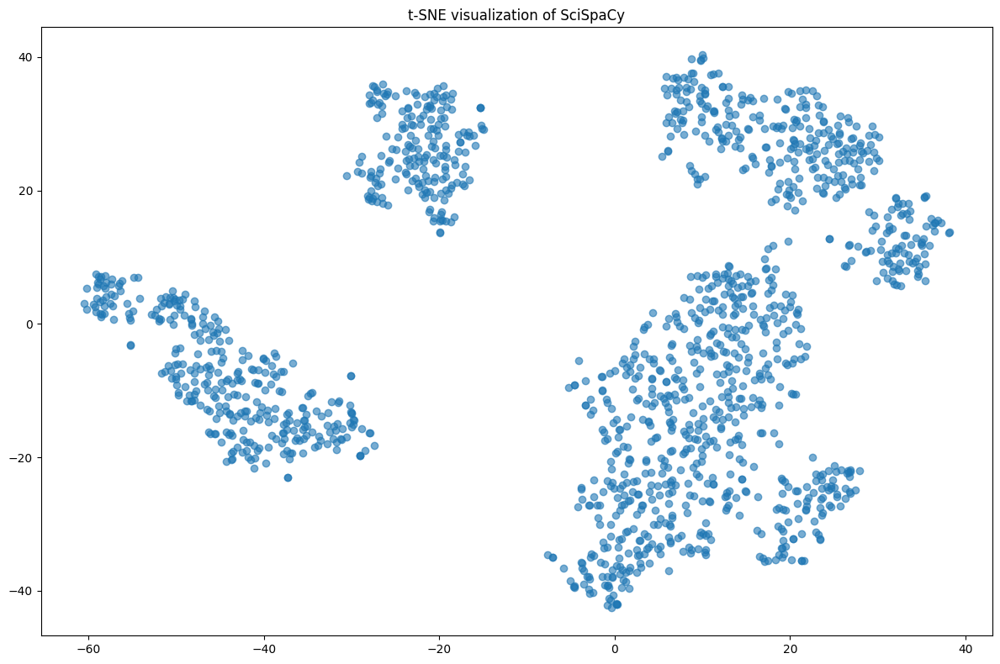

In [25]:
w2v_model, tsne_results = visualize_clinical_notes(sci_spa_results_df, "t-SNE visualization of SciSpaCy")

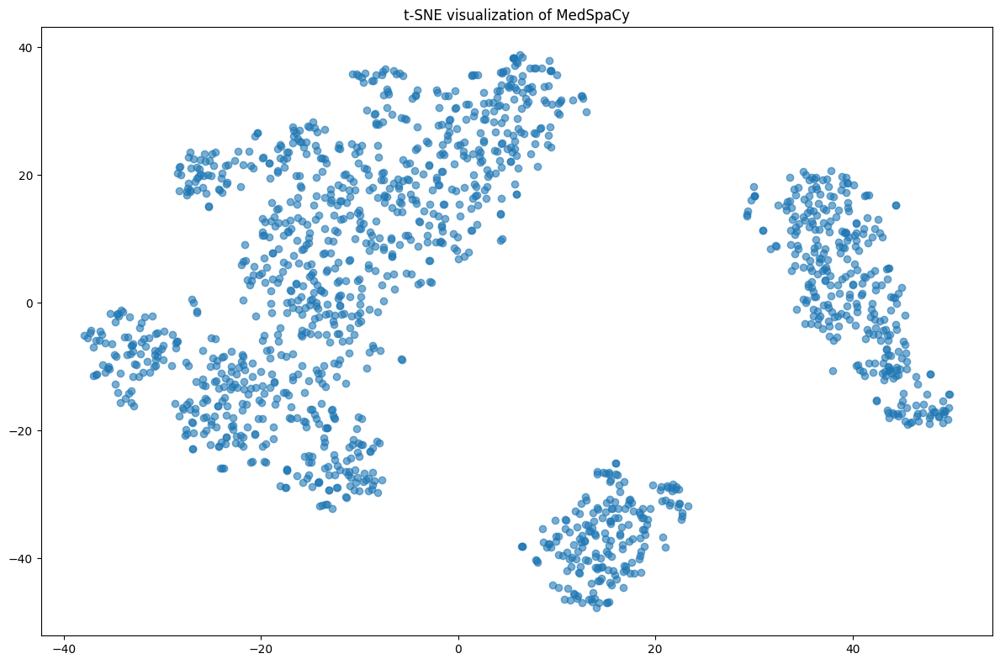

In [26]:
w2v_model, tsne_results = visualize_clinical_notes(med_results_df, "t-SNE visualization of MedSpaCy")

In [37]:
import numpy as np
from gensim.models import Word2Vec
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

def get_most_common_entity_type(entities):
    if not entities:
        return 'NO_ENTITY'
    entity_types = [ent[1] for ent in entities]
    return Counter(entity_types).most_common(1)[0][0]

def plot_tsne_with_entities(results_df, tsne_results, title, entity_type='all', min_count=10):
    plt.figure(figsize=(15, 10))

    # Create entity-based colors
    entity_colors = {}
    all_entities = []

    # Collect all entities and their counts
    for idx, row in results_df.iterrows():
        entities = row['processed_data']['entities']
        for ent_text, ent_label in entities:
            if entity_type == 'all' or ent_label == entity_type:
                all_entities.append((ent_text, ent_label))

    # Count entities
    entity_counts = Counter(all_entities)

    # Create color mapping for frequent entities
    frequent_entities = [ent for ent, count in entity_counts.items()
                        if count >= min_count]
    colors = plt.cm.rainbow(np.linspace(0, 1, len(frequent_entities)))
    entity_colors = dict(zip(frequent_entities, colors))

    # Plot points
    scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1],
                         c='lightgray', alpha=0.5, s=50)

    # Add entity labels for frequent entities
    for idx, row in results_df.iterrows():
        entities = row['processed_data']['entities']
        for ent_text, ent_label in entities:
            if (ent_text, ent_label) in frequent_entities:
                plt.annotate(f"{ent_text} ({ent_label})",
                           (tsne_results[idx, 0], tsne_results[idx, 1]),
                           alpha=0.7,
                           fontsize=8)

    plt.title(f"{title}\nShowing entities with min {min_count} occurrences")

    plt.tight_layout()
    plt.show()

def visualize_entity_distribution(results_df, title):
    # Collect all entity types and their counts
    entity_types = []
    for idx, row in results_df.iterrows():
        entities = row['processed_data']['entities']
        entity_types.extend([ent[1] for ent in entities])

    # Count entity types
    type_counts = Counter(entity_types)

    # Create bar plot
    plt.figure(figsize=(12, 6))
    plt.bar(type_counts.keys(), type_counts.values())
    plt.xticks(rotation=45, ha='right')
    plt.title(title)
    plt.ylabel('Count')
    plt.tight_layout()
    plt.show()

    return type_counts

# Modified main processing pipeline
def visualize_clinical_notes_with_entities(results_df, title):
    # Prepare sentences
    sentences = prepare_sentences(results_df)

    # Train Word2Vec model
    w2v_model = train_word2vec(sentences)

    # Get document vectors
    doc_vectors = get_document_vectors(w2v_model, sentences)

    # Perform t-SNE
    tsne_results = perform_tsne(doc_vectors)

    plot_tsne_with_entities(results_df, tsne_results, title, min_count=10)

    return w2v_model, tsne_results


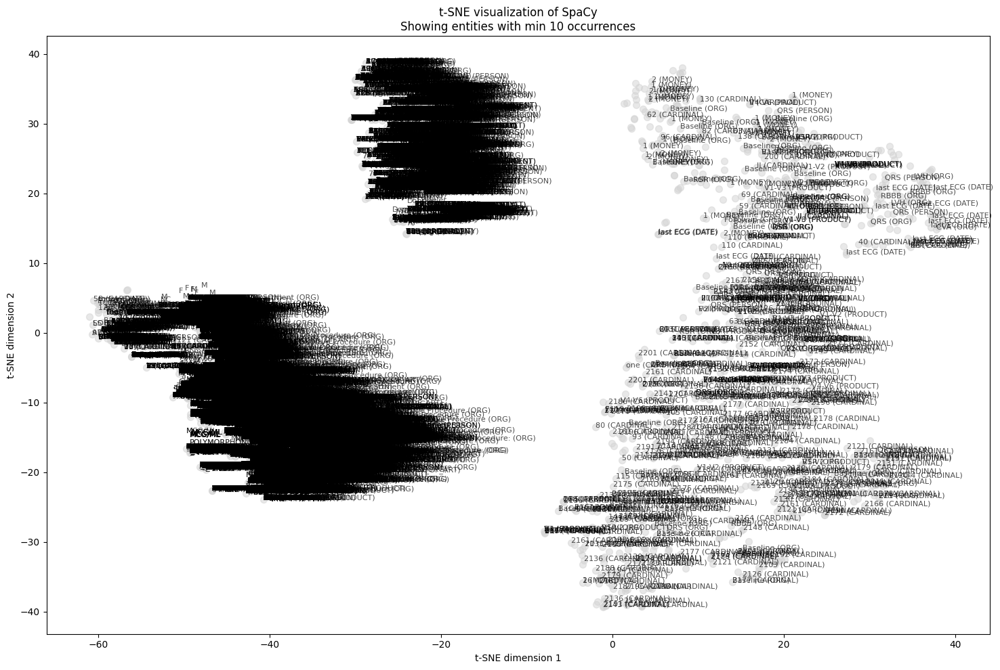

In [38]:
w2v_model, tsne_results = visualize_clinical_notes_with_entities(results_df, "t-SNE visualization of SpaCy")

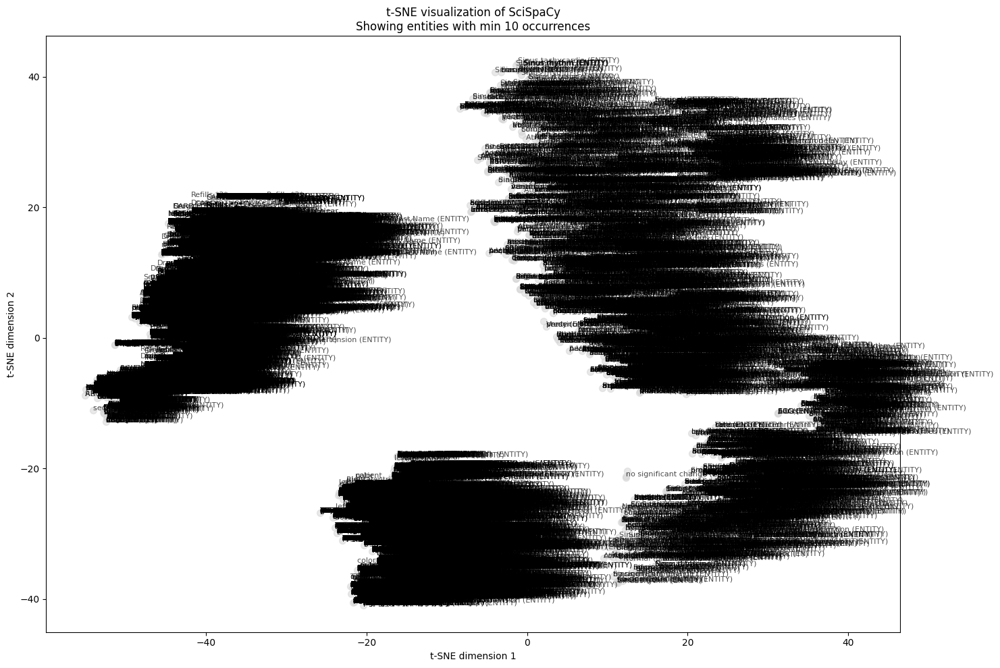

In [39]:
w2v_model, tsne_results = visualize_clinical_notes_with_entities(sci_spa_results_df, "t-SNE visualization of SciSpaCy")

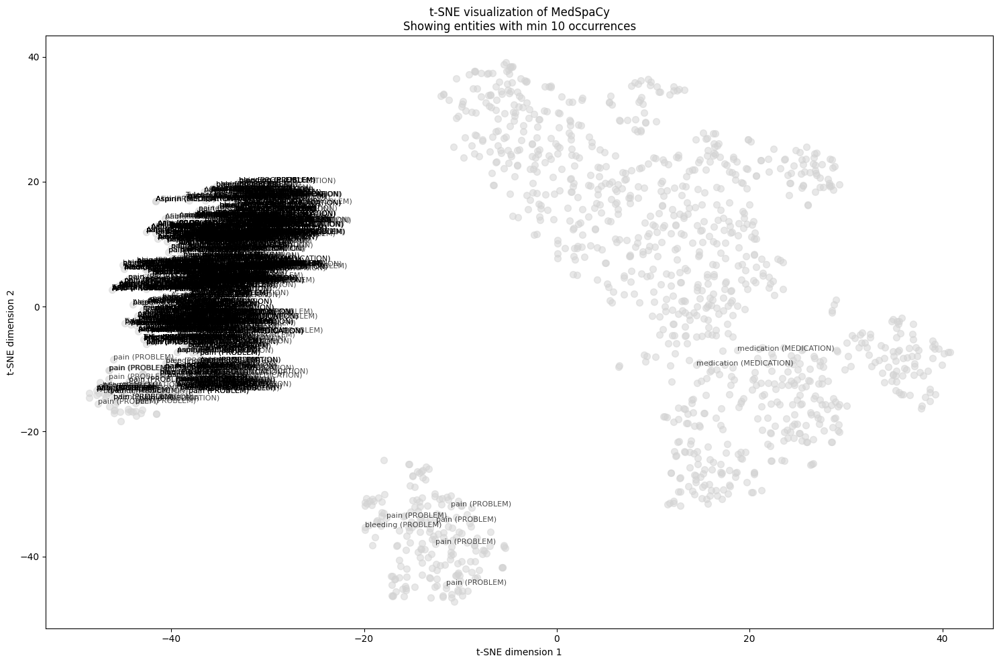

In [40]:
w2v_model, tsne_results = visualize_clinical_notes_with_entities(med_results_df, "t-SNE visualization of MedSpaCy")